<a href="https://colab.research.google.com/github/gitvhiz/dsprojects/blob/main/Bubble_Segmentation_Pilot_Version.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Bubble Segmentation using StarDist

Goal: To build an image segmentation algorithm which identifies ozone (gas) bubbles released from a [sparger]("https://www.hengko.com/news/what-is-a-sparger-in-bioreactor-all-you-want-to-know/") into a water (liquid) medium in a [bubble column reactor]("https://en.wikipedia.org/wiki/Bubble_column_reactor").

Papers and websites referenced:

* [Prediction of Bubble Sizes in Bubble Columns with Machine Learning Methods](https://onlinelibrary.wiley.com/doi/full/10.1002/cite.202100157)

* [ScienceDirect : Determination of Bubble Sizes using Machine Learning Regression Methods](https://www.sciencedirect.com/science/article/pii/S0263876220304391#:~:text=As%20a%20highlight%2C%20it%20is,below%20the%20sensor's%20spatial%20resolution.)

* [Bubble Trajectory in a Bubble Column Reactor using Combined Image Processing and Artificial Neural Network](https://www.degruyter.com/document/doi/10.1515/ijcre-2015-0186/html?lang=en)

* [StarDist - GitHub](https://github.com/stardist/stardist)

* [279 - An introduction to object segmentation using StarDist library in Python](https://www.youtube.com/watch?v=3yk9sBja7YI)

* [280 - Custom object segmentation using StarDist library in python](https://www.youtube.com/watch?v=F6sfm1i8OfY)

* [Digital Sreeni's YouTube Channel](https://www.youtube.com/c/DigitalSreeni)

## Segmenting sample nuclei data from the StarDist library using a pretrained StarDist model

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install stardist

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 24.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.8/69.8 kB 6.0 MB/s eta 0:00:00


In [3]:
from stardist.models import StarDist2D
from stardist.data import test_image_nuclei_2d
from stardist.plot import render_label
from csbdeep.utils import normalize
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import warnings
warnings.filterwarnings('ignore')

In [4]:
# list of available models
StarDist2D.from_pretrained()

There are 4 registered models for 'StarDist2D':

Name                  Alias(es)
────                  ─────────
'2D_versatile_fluo'   'Versatile (fluorescent nuclei)'
'2D_versatile_he'     'Versatile (H&E nuclei)'
'2D_paper_dsb2018'    'DSB 2018 (from StarDist 2D paper)'
'2D_demo'             None


## Example 1: Nuclei Segmentation using 2D_versatile_fluo

In [5]:
# Segment nuclei in fluoroscence images (pretrained)
model = StarDist2D.from_pretrained('2D_versatile_fluo')

Found model '2D_versatile_fluo' for 'StarDist2D'.
5320433/5320433 [==============================] - 0s 0us/step
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


Text(0.5, 1.0, 'Input + Prediction Overlay')

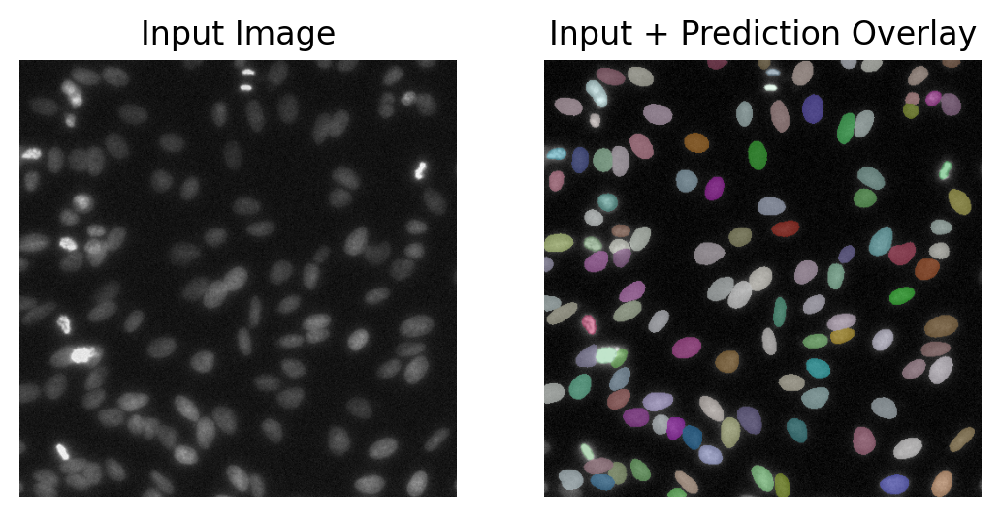

In [6]:
img = test_image_nuclei_2d()

# Segmentation (predicting instances and labels)

labels, _ = model.predict_instances(normalize(img))

plt.subplot(1,2,1)
plt.imshow(img, cmap = 'gray')
plt.axis("off")
plt.title('Input Image')

plt.subplot(1,2,2)
plt.imshow(render_label(labels, img = img))
plt.axis("off")
plt.title("Input + Prediction Overlay")

## Example 2 : Custom Segmentation (Pretrained Model)

In [7]:
from skimage import io

In [8]:
my_f1_img = io.imread('/content/drive/MyDrive/Colab Notebooks/Data/images/custom_nuclei1.png', as_gray = True)

In [9]:
my_f1_img = my_f1_img[200:1000, 200:1000]

(-0.5, 799.5, 799.5, -0.5)

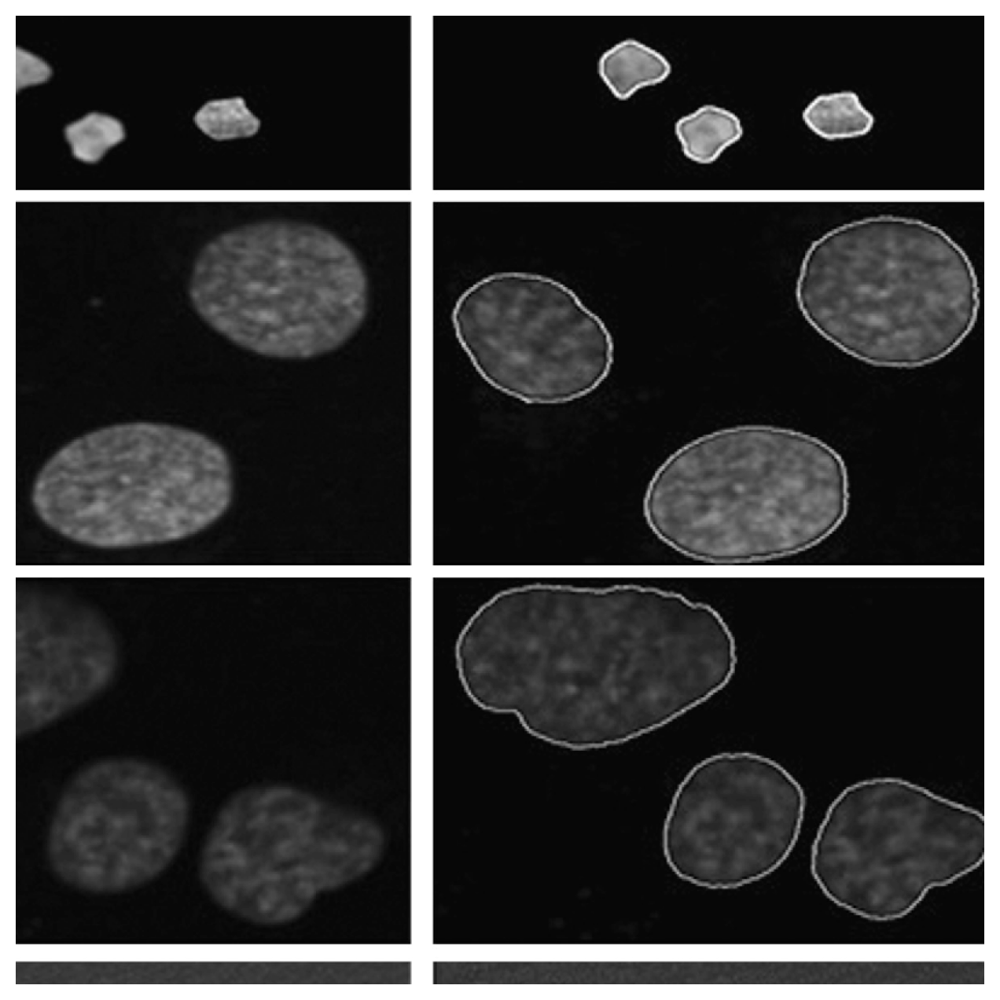

In [10]:
plt.figure(figsize = (8,8))
plt.imshow(my_f1_img, cmap = 'gray')
plt.axis("off")

In [11]:
my_f1_labels, my_f1_details = model.predict_instances(normalize(my_f1_img))

Text(0.5, 1.0, 'Input + Prediction Overlay')

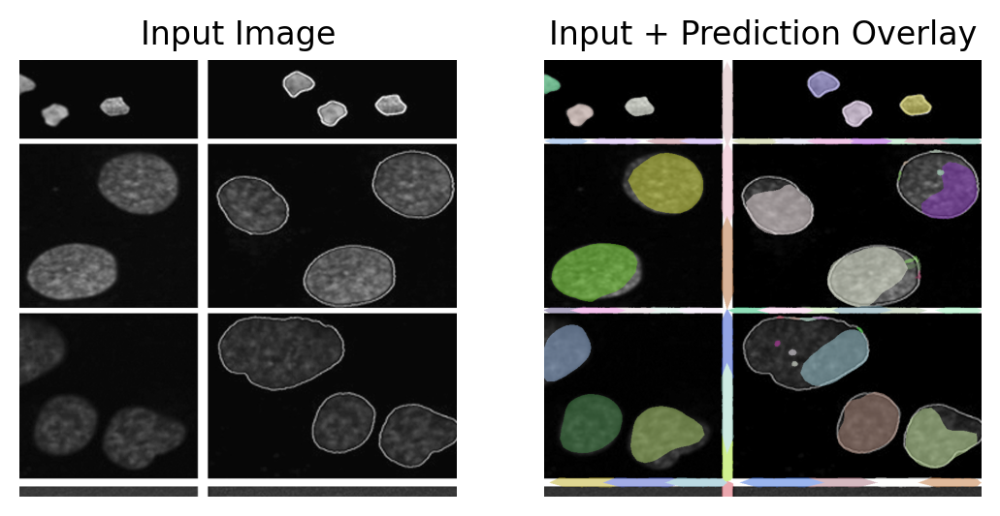

In [12]:
plt.subplot(1,2,1)
plt.imshow(my_f1_img, cmap = "gray")
plt.axis("off")
plt.title("Input Image")

plt.subplot(1,2,2)
plt.imshow(render_label(my_f1_labels, img = my_f1_img))
plt.axis("off")
plt.title("Input + Prediction Overlay")

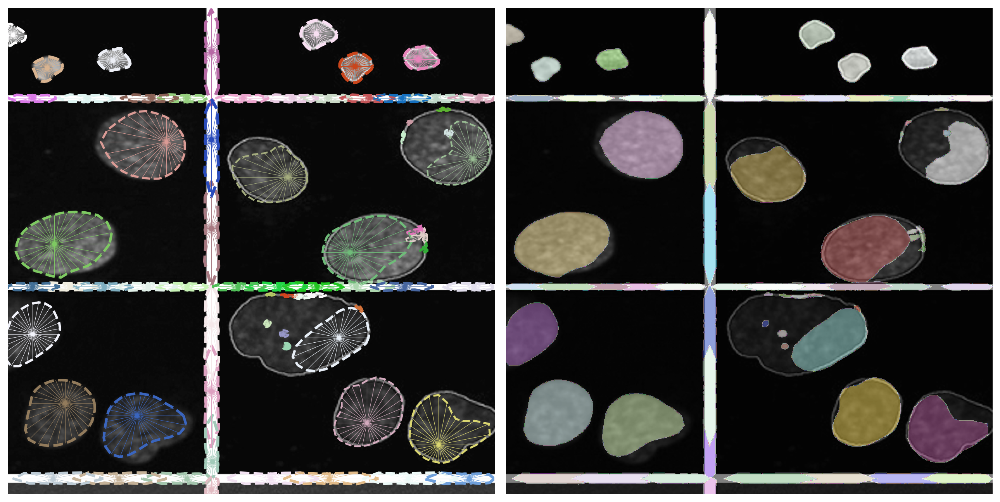

In [13]:
from stardist import random_label_cmap, _draw_polygons, export_imagej_rois
import numpy as np
np.random.seed(6)
lbl_cmap = random_label_cmap()

plt.figure(figsize=(13,10))
img_show = my_f1_img if my_f1_img.ndim==2 else my_f1_img[...,0]
coord, points, prob = my_f1_details['coord'], my_f1_details['points'], my_f1_details['prob']
plt.subplot(121); plt.imshow(img_show, cmap='gray'); plt.axis('off')
a = plt.axis()
_draw_polygons(coord, points, prob, show_dist= True)
plt.axis(a)
plt.subplot(122); plt.imshow(img_show, cmap='gray'); plt.axis('off')
plt.imshow(my_f1_labels, cmap=lbl_cmap, alpha=0.5)
plt.tight_layout()
plt.show()

## Training a custom StarDist model

_Code adapted from [this notebook](https://colab.research.google.com/github/bnsreenu/python_for_microscopists/blob/master/280a_custom_object_segmentation_using_stardist_TRAIN.ipynb#scrollTo=LcUjAQbc30xD) by [Digital Sreeni](https://www.youtube.com/watch?v=F6sfm1i8OfY)_

In [14]:
from __future__ import print_function, unicode_literals, absolute_import, division
import sys
import numpy as np
import matplotlib
#matplotlib.rcParams["image.interpolation"] = None
import matplotlib.pyplot as plt


from glob import glob
from tqdm import tqdm
from skimage.io import imread
from csbdeep.utils import Path, normalize

from stardist import fill_label_holes, random_label_cmap, calculate_extents, gputools_available
from stardist.matching import matching, matching_dataset
from stardist.models import Config2D, StarDist2D, StarDistData2D

In [15]:
#Random color map labels
np.random.seed(42)
lbl_cmap = random_label_cmap()

### Loading and Preprocessing Data

In [16]:
X_paths = sorted(glob('/content/drive/MyDrive/Colab Notebooks/Data/AnnotationStardist/img/*.png'))
#for path in X_paths:
#    print(path)

In [17]:
Y_paths = sorted(glob('/content/drive/MyDrive/Colab Notebooks/Data/AnnotationStardist/mask/*.png'))
#for path in Y_paths:
#  print(path)

In [18]:
X = [imread(path) for path in X_paths]
Y = [imread(path) for path in Y_paths]

In [19]:
#X

In [20]:
#Y

In [21]:
n_channel = 1 if X[0].ndim == 2 else X[0].shape[-1]  #If no third dim. then number of channels = 1. Otherwise get the num channels from the last dim.

In [22]:
#Normalize input images and fill holes in masks
axis_norm = (0,1)   # normalize channels independently
# axis_norm = (0,1,2) # normalize channels jointly
if n_channel > 1:
    print("Normalizing image channels %s." % ('jointly' if axis_norm is None or 2 in axis_norm else 'independently'))
    sys.stdout.flush()

X = [normalize(x,1,99.8,axis=axis_norm) for x in tqdm(X)]
Y = [fill_label_holes(y) for y in tqdm(Y)]

100%|██████████| 414/414 [00:07<00:00, 52.34it/s]


In [23]:
#Split to train and val
#You can use any method to split. I am following the method used in StarDist documentation example
assert len(X) > 1, "not enough training data"
rng = np.random.RandomState(42)
ind = rng.permutation(len(X))
n_val = max(1, int(round(0.15 * len(ind))))
ind_train, ind_val = ind[:-n_val], ind[-n_val:]
X_val, Y_val = [X[i] for i in ind_val]  , [Y[i] for i in ind_val]
X_trn, Y_trn = [X[i] for i in ind_train], [Y[i] for i in ind_train]
print('number of images: %3d' % len(X))
print('- training:       %3d' % len(X_trn))
print('- validation:     %3d' % len(X_val))

number of images: 414
- training:       352
- validation:      62


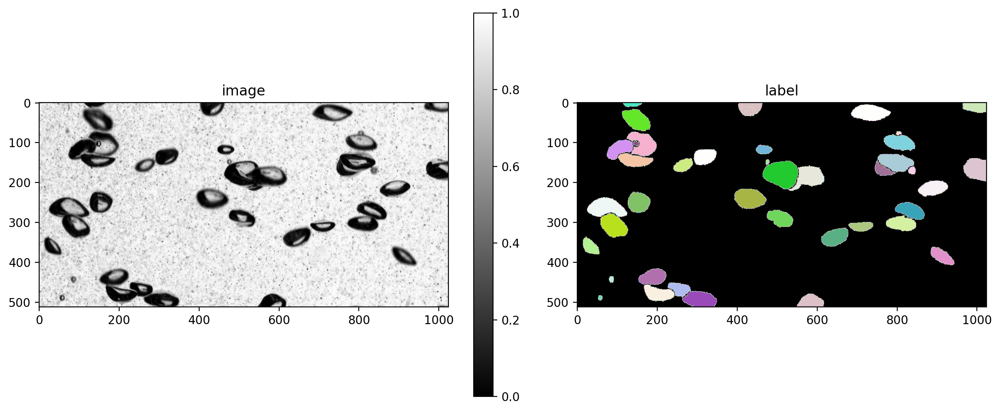

In [24]:
#Plot image and label for some images - sanity check
def plot_img_label(img, lbl, img_title="image", lbl_title="label", **kwargs):
    fig, (ai,al) = plt.subplots(1,2, figsize=(12,5), gridspec_kw=dict(width_ratios=(1.25,1)))
    im = ai.imshow(img, cmap='gray', clim=(0,1))
    ai.set_title(img_title)
    fig.colorbar(im, ax=ai)
    al.imshow(lbl, cmap=lbl_cmap)
    al.set_title(lbl_title)
    plt.tight_layout()


i = min(9, len(X)-1)

img, lbl = X[i], Y[i]
assert img.ndim in (2,3)
img = img if (img.ndim==2 or img.shape[-1]==3) else img[...,0]
plot_img_label(img,lbl)

In [25]:
#Check config to get an idea about all parameters
print(Config2D.__doc__)

Configuration for a :class:`StarDist2D` model.

    Parameters
    ----------
    axes : str or None
        Axes of the input images.
    n_rays : int
        Number of radial directions for the star-convex polygon.
        Recommended to use a power of 2 (default: 32).
    n_channel_in : int
        Number of channels of given input image (default: 1).
    grid : (int,int)
        Subsampling factors (must be powers of 2) for each of the axes.
        Model will predict on a subsampled grid for increased efficiency and larger field of view.
    n_classes : None or int
        Number of object classes to use for multi-class predection (use None to disable)
    backbone : str
        Name of the neural network architecture to be used as backbone.
    kwargs : dict
        Overwrite (or add) configuration attributes (see below).


    Attributes
    ----------
    unet_n_depth : int
        Number of U-Net resolution levels (down/up-sampling layers).
    unet_kernel_size : (int,int)
   

In [26]:
#Define the config by setting some parameter values

n_rays = 32  #Number of radial directions for the star-convex polygon.

# Use OpenCL-based computations for data generator during training (requires 'gputools')
use_gpu = False and gputools_available()

# Predict on subsampled grid for increased efficiency and larger field of view
grid = (2,2)

conf = Config2D (
    n_rays       = n_rays,
    grid         = grid,
    use_gpu      = use_gpu,
    n_channel_in = n_channel,
)
print(conf)
vars(conf)

Config2D(n_dim=2, axes='YXC', n_channel_in=1, n_channel_out=33, train_checkpoint='weights_best.h5', train_checkpoint_last='weights_last.h5', train_checkpoint_epoch='weights_now.h5', n_rays=32, grid=(2, 2), backbone='unet', n_classes=None, unet_n_depth=3, unet_kernel_size=(3, 3), unet_n_filter_base=32, unet_n_conv_per_depth=2, unet_pool=(2, 2), unet_activation='relu', unet_last_activation='relu', unet_batch_norm=False, unet_dropout=0.0, unet_prefix='', net_conv_after_unet=128, net_input_shape=(None, None, 1), net_mask_shape=(None, None, 1), train_shape_completion=False, train_completion_crop=32, train_patch_size=(256, 256), train_background_reg=0.0001, train_foreground_only=0.9, train_sample_cache=True, train_dist_loss='mae', train_loss_weights=(1, 0.2), train_class_weights=(1, 1), train_epochs=400, train_steps_per_epoch=100, train_learning_rate=0.0003, train_batch_size=4, train_n_val_patches=None, train_tensorboard=True, train_reduce_lr={'factor': 0.5, 'patience': 40, 'min_delta': 0}, 

{'n_dim': 2,
 'axes': 'YXC',
 'n_channel_in': 1,
 'n_channel_out': 33,
 'train_checkpoint': 'weights_best.h5',
 'train_checkpoint_last': 'weights_last.h5',
 'train_checkpoint_epoch': 'weights_now.h5',
 'n_rays': 32,
 'grid': (2, 2),
 'backbone': 'unet',
 'n_classes': None,
 'unet_n_depth': 3,
 'unet_kernel_size': (3, 3),
 'unet_n_filter_base': 32,
 'unet_n_conv_per_depth': 2,
 'unet_pool': (2, 2),
 'unet_activation': 'relu',
 'unet_last_activation': 'relu',
 'unet_batch_norm': False,
 'unet_dropout': 0.0,
 'unet_prefix': '',
 'net_conv_after_unet': 128,
 'net_input_shape': (None, None, 1),
 'net_mask_shape': (None, None, 1),
 'train_shape_completion': False,
 'train_completion_crop': 32,
 'train_patch_size': (256, 256),
 'train_background_reg': 0.0001,
 'train_foreground_only': 0.9,
 'train_sample_cache': True,
 'train_dist_loss': 'mae',
 'train_loss_weights': (1, 0.2),
 'train_class_weights': (1, 1),
 'train_epochs': 400,
 'train_steps_per_epoch': 100,
 'train_learning_rate': 0.0003,


In [27]:
if use_gpu:
    from csbdeep.utils.tf import limit_gpu_memory
    # adjust as necessary: limit GPU memory to be used by TensorFlow to leave some to OpenCL-based computations
    limit_gpu_memory(0.8)

In [28]:
#Save model to the specified directory
model = StarDist2D(conf, name='stardist_model_1', basedir='/content/drive/MyDrive/Colab Notebooks/models')

Using default values: prob_thresh=0.5, nms_thresh=0.4.


In [29]:
#Define a few augmentation methods
def random_fliprot(img, mask):
    assert img.ndim >= mask.ndim
    axes = tuple(range(mask.ndim))
    perm = tuple(np.random.permutation(axes))
    img = img.transpose(perm + tuple(range(mask.ndim, img.ndim)))
    mask = mask.transpose(perm)
    for ax in axes:
        if np.random.rand() > 0.5:
            img = np.flip(img, axis=ax)
            mask = np.flip(mask, axis=ax)
    return img, mask

def random_intensity_change(img):
    img = img*np.random.uniform(0.6,2) + np.random.uniform(-0.2,0.2)
    return img


def augmenter(x, y):
    """Augmentation of a single input/label image pair.
    x is an input image
    y is the corresponding ground-truth label image
    """
    x, y = random_fliprot(x, y)
    x = random_intensity_change(x)
    # add some gaussian noise
    sig = 0.02*np.random.uniform(0,1)
    x = x + sig*np.random.normal(0,1,x.shape)
    return x, y

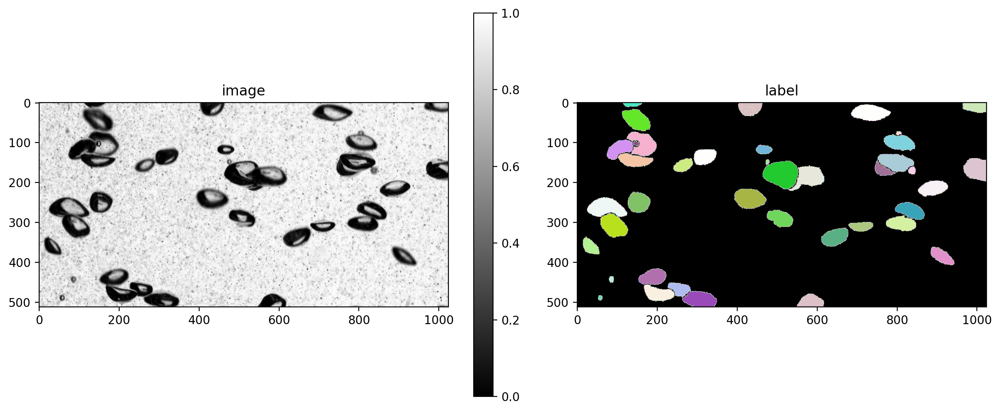

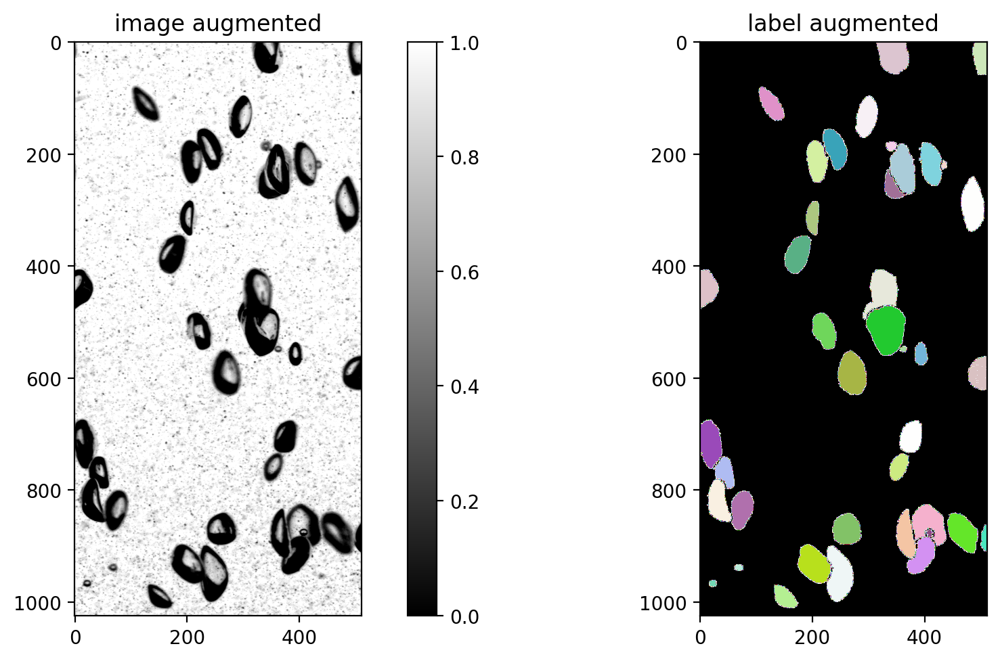

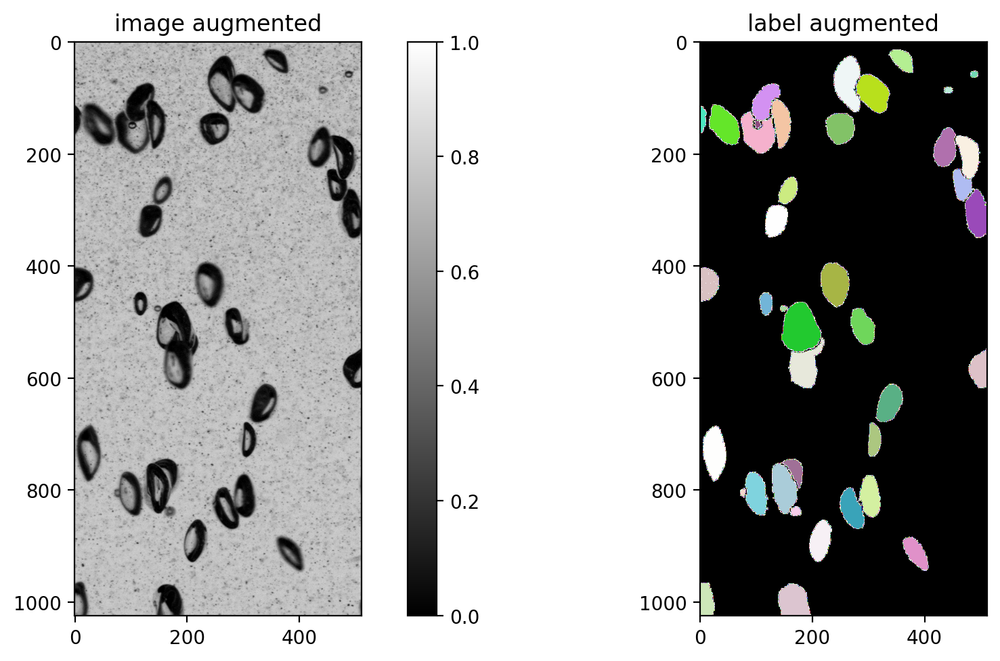

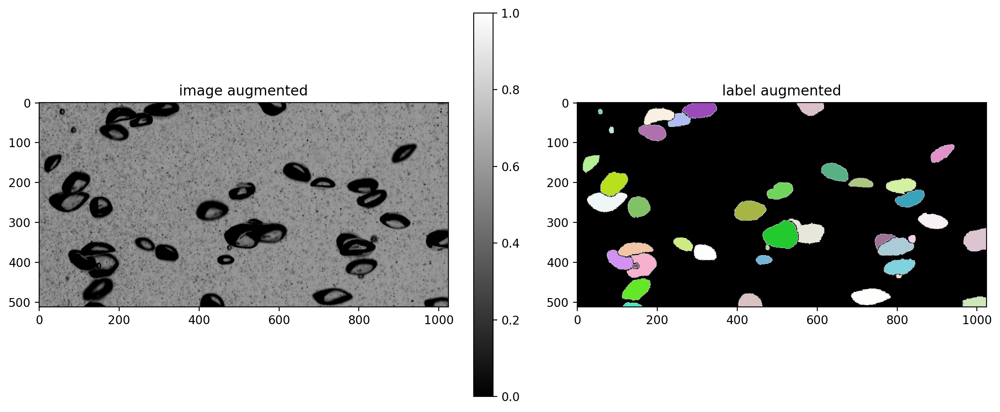

In [30]:
# plot some augmented examples
img, lbl = X[9],Y[9]
plot_img_label(img, lbl)
for _ in range(3):
    img_aug, lbl_aug = augmenter(img,lbl)
    plot_img_label(img_aug, lbl_aug, img_title="image augmented", lbl_title="label augmented")

In [31]:
model.train(X_trn, Y_trn, validation_data=(X_val,Y_val), augmenter=augmenter, epochs=10, steps_per_epoch=100)

Epoch 1/10


Cause: Unable to locate the source code of <function _gcd_import at 0x7ab726ae7400>. Note that functions defined in certain environments, like the interactive Python shell, do not expose their source code. If that is the case, you should define them in a .py source file. If you are certain the code is graph-compatible, wrap the call using @tf.autograph.experimental.do_not_convert. Original error: could not get source code
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Cause: Unable to locate the source code of <function _gcd_import at 0x7ab726ae7400>. Note that functions defined in certain environments, like the interactive Python shell, do not expose their source code. If that is the case, you should define them in a .py source file. If you are certain the code is graph-compatible, wrap the call using @tf.autograph.experimental.do_not_convert. Original error: could not get source code
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
100/100 [==============================] - 316s 3s/step - loss: 4.3574 - prob_loss: 0.3657 - dist_loss: 19.9587 - prob_kld: 0.2479 - dist_relevant_mae: 19.9576 - dist_relevant_mse: 703.7758 - dist_dist_iou_metric: 0.1236 - val_loss: 3.2636 - val_prob_loss: 0.3060 - val_dist_loss: 14.7881 - val_prob_kld: 0.1939 - val_dist_relevant_mae: 14.7864 - val_dist_relevant_mse: 468.1725 - val_dist_dist_iou_metric: 0.2344 - lr: 3.0000e-04
Epoch 2/10
100/100 [=============================

In [32]:
#Optimize the thresolds using the trained model
model.optimize_thresholds(X_val, Y_val)

NMS threshold = 0.5:  75%|███████▌  | 15/20 [02:36<00:52, 10.40s/it, 0.669 -> 0.452]


Using optimized values: prob_thresh=0.638415, nms_thresh=0.3.
Saving to 'thresholds.json'.


{'prob': 0.638414944904532, 'nms': 0.3}

In [33]:
#Load saved model
my_model = StarDist2D(None, name='stardist_model_1', basedir='/content/drive/MyDrive/Colab Notebooks/models')

Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.638415, nms_thresh=0.3.


In [34]:
model=my_model

In [35]:
#Predict on validation images
Y_val_pred = [model.predict_instances(x, n_tiles=model._guess_n_tiles(x), show_tile_progress=False)[0]
              for x in tqdm(X_val)]

100%|██████████| 62/62 [02:32<00:00,  2.47s/it]


100%|██████████| 9/9 [00:15<00:00,  1.72s/it]


DatasetMatching(criterion='iou', thresh=0.5, fp=802, tp=2301, fn=1163, precision=0.7415404447309055, recall=0.6642609699769053, accuracy=0.539381153305204, f1=0.700776610324349, n_true=3464, n_pred=3103, mean_true_score=0.4615500240347953, mean_matched_score=0.694832369950687, panoptic_quality=0.4869222729576765, by_image=False)

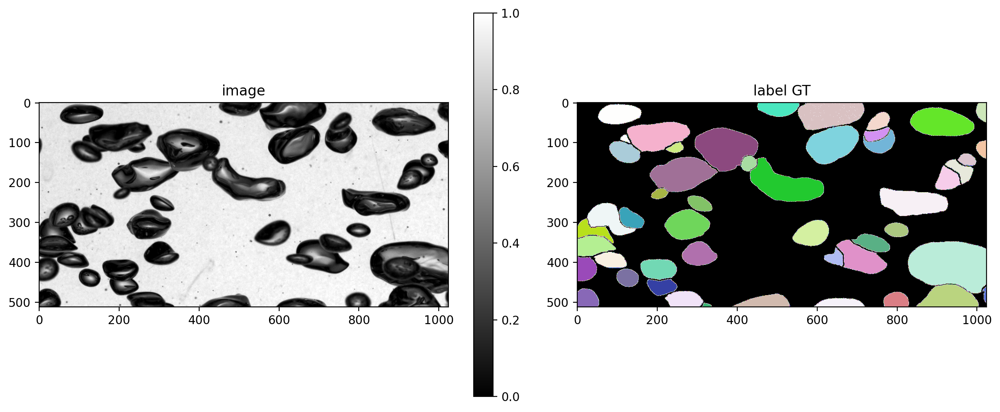

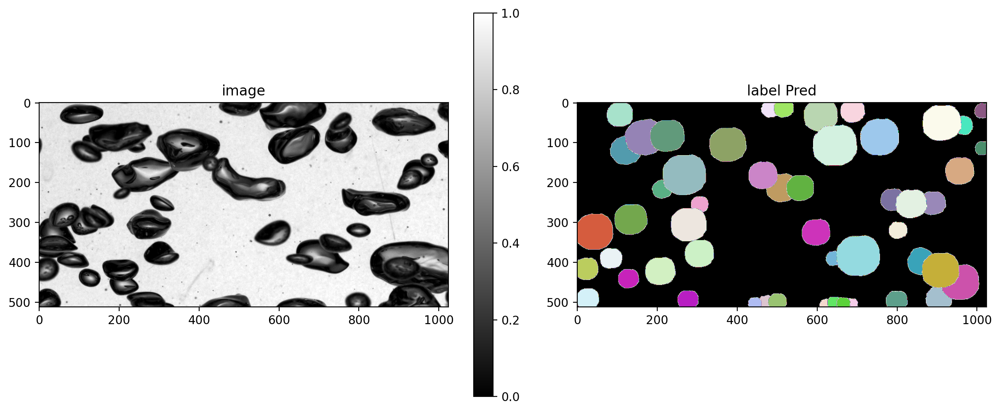

In [36]:
#Plot original labels and predcitions
plot_img_label(X_val[0],Y_val[0], lbl_title="label GT")
plot_img_label(X_val[0],Y_val_pred[0], lbl_title="label Pred")


taus = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
stats = [matching_dataset(Y_val, Y_val_pred, thresh=t, show_progress=False) for t in tqdm(taus)]

stats[taus.index(0.5)]

## Segment any image

In [37]:
X[0].shape

(512, 1024)

In [38]:
#Define the number of channels and normalize images with independendt channels or jointly
n_channel = 1 if X[0].ndim == 2 else X[0].shape[-1]
axis_norm = (0,1)   # normalize channels independently
# axis_norm = (0,1,2) # normalize channels jointly
if n_channel > 1:
    print("Normalizing image channels %s." % ('jointly' if axis_norm is None or 2 in axis_norm else 'independently'))
X = [normalize(x,1,99.8,axis=axis_norm) for x in tqdm(X)]

100%|██████████| 414/414 [00:07<00:00, 52.31it/s]


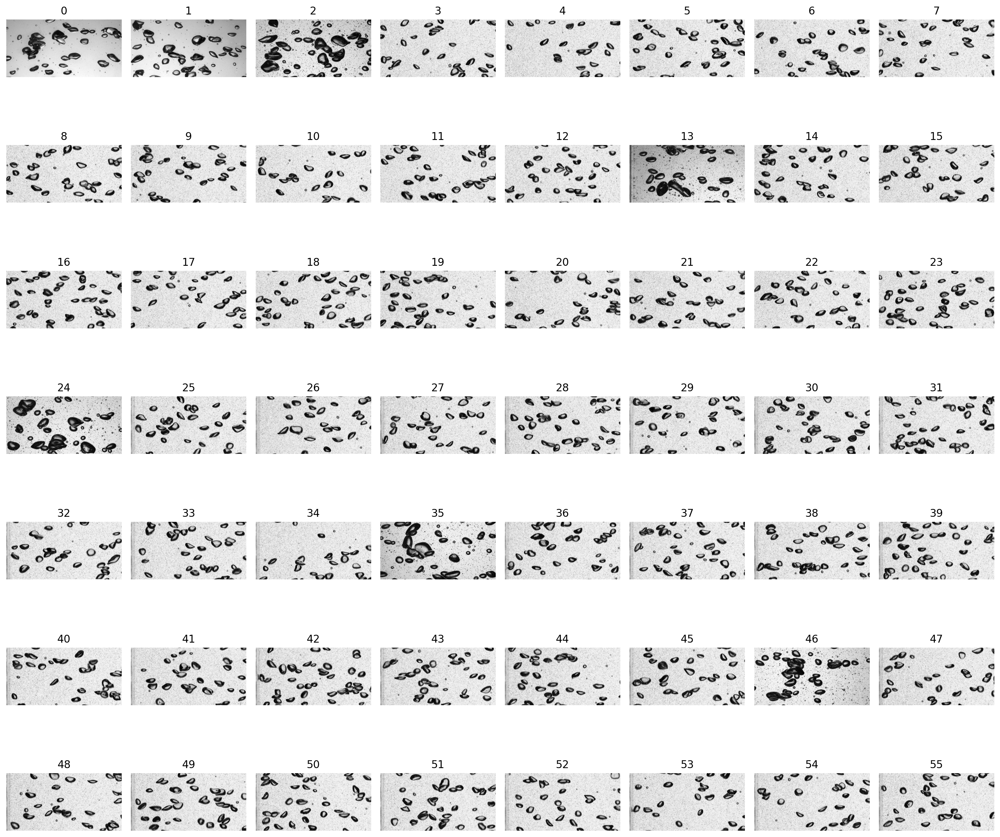

In [39]:
fig, ax = plt.subplots(7,8, figsize=(16,16))
for i,(a,x) in enumerate(zip(ax.flat, X)):
  a.imshow(x if x.ndim==2 else x[...,0], cmap='gray')
  a.set_title(i)
  [a.axis('off') for a in ax.flat]
  plt.tight_layout()

In [40]:
from random import randint

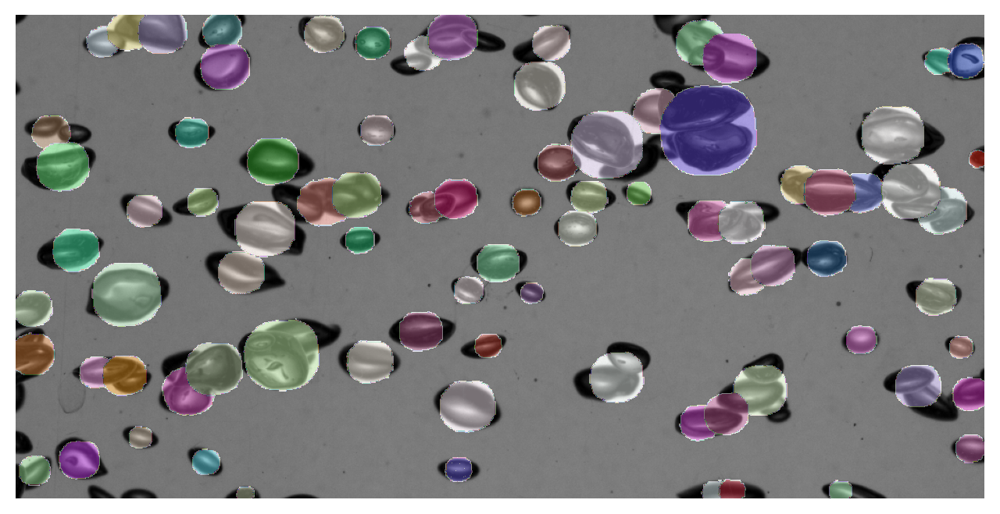

In [41]:
img_num = randint(0, len(X)-1)
img = X[img_num]
#img = normalize(X[16], 1,99.8, axis=axis_norm)
labels, details = model.predict_instances(img)


plt.figure(figsize=(8,8))
plt.imshow(img if img.ndim==2 else img[...,0], clim=(0,1), cmap='gray')
plt.imshow(labels, cmap=lbl_cmap, alpha=0.5)
plt.axis('off');

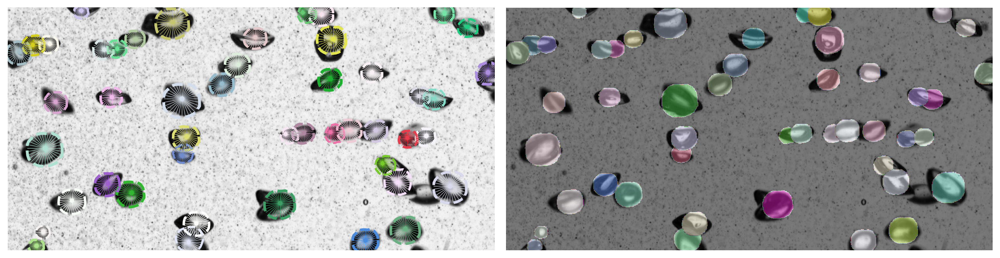

In [42]:
#Plot

def example(model, i, show_dist=True):
    img = normalize(X[i], 1,99.8, axis=axis_norm)
    labels, details = model.predict_instances(img)

    plt.figure(figsize=(13,10))
    img_show = img if img.ndim==2 else img[...,0]
    coord, points, prob = details['coord'], details['points'], details['prob']
    plt.subplot(121); plt.imshow(img_show, cmap='gray'); plt.axis('off')
    a = plt.axis()
    _draw_polygons(coord, points, prob, show_dist=show_dist)
    plt.axis(a)
    plt.subplot(122); plt.imshow(img_show, cmap='gray'); plt.axis('off')
    plt.imshow(labels, cmap=lbl_cmap, alpha=0.5)
    plt.tight_layout()
    plt.show()


example(model, 16)

## Segmenting the bubble images

In [51]:
my_img = imread('/content/drive/MyDrive/Colab Notebooks/Data/images/bubble1.JPG')

In [52]:
my_img.shape

(3456, 5184, 3)

Here, the image is colored (3 color channels). Before passing it to our StarDist model, we will first convert it to a grayscale image.

This can be done with the `rgb2gray` function in the `skimage.color` module.

Alternatively, just set the `as_gray` parameter to `True` in the `imread` instance.

In [53]:
my_img = imread('/content/drive/MyDrive/Colab Notebooks/Data/images/bubble1.JPG', as_gray = True)

In [54]:
my_img.shape

(3456, 5184)

In [55]:
my_img_norm = normalize(my_img, 1,99.8, axis=axis_norm)

In [56]:
segmented_img, details_img = model.predict_instances(my_img_norm, verbose=True)

predicting instances with nms_thresh = 0.3
non-maximum suppression...
keeping 122/12288 polyhedra
NMS took 1.1001 s


Text(0.5, 1.0, 'prediction')

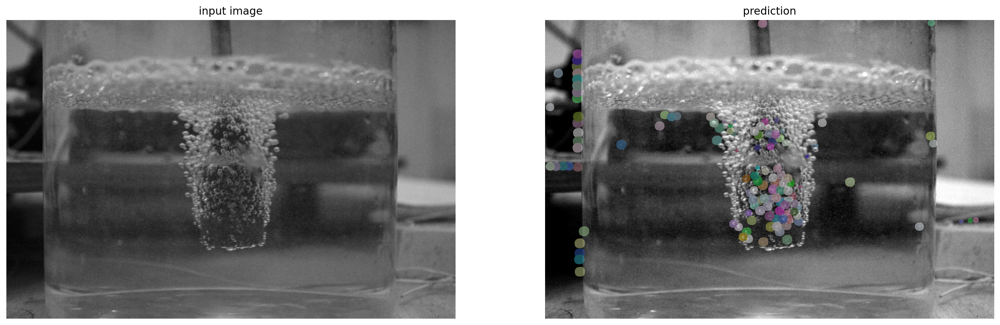

In [57]:
plt.figure(figsize = (20,10))
plt.subplot(1,2,1)
plt.imshow(my_img_norm, cmap="gray")
plt.axis("off")
plt.title("input image")

plt.subplot(1,2,2)
plt.imshow(render_label(segmented_img, img=my_img_norm))
plt.axis("off")
plt.title("prediction")

In [58]:
my_img_2 = imread('/content/drive/MyDrive/Colab Notebooks/Data/images/bubble2.JPG', as_gray = True)

In [60]:
my_img_2_norm = normalize(my_img_2, 1,99.8, axis=axis_norm)

In [61]:
segmented_img, details_img = model.predict_instances(my_img_2_norm, verbose=True)

predicting instances with nms_thresh = 0.3
non-maximum suppression...
keeping 249/28185 polyhedra
NMS took 0.6343 s


Text(0.5, 1.0, 'prediction')

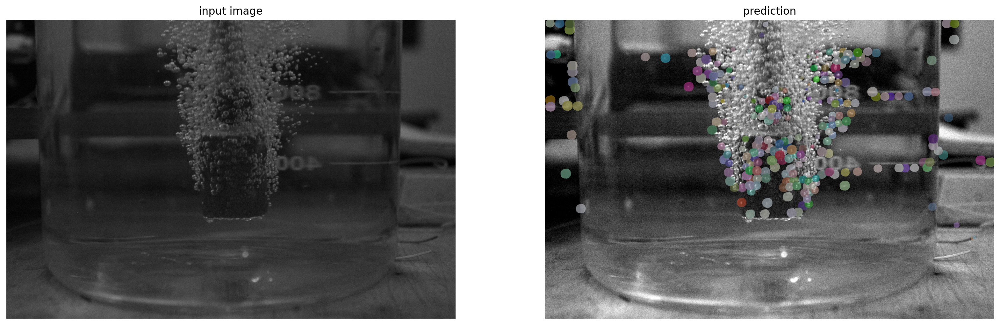

In [62]:
plt.figure(figsize = (20,10))
plt.subplot(1,2,1)
plt.imshow(my_img_2_norm, cmap="gray")
plt.axis("off")
plt.title("input image")

plt.subplot(1,2,2)
plt.imshow(render_label(segmented_img, img=my_img_2_norm))
plt.axis("off")
plt.title("prediction")

## Key Observations from segmenting on the sparger images

1. Images from the [Annotation StarDist dataset used for training the StarDist Model](https://rodare.hzdr.de/record/1473) were taken from a much closer distance and at a much higher resolution.
This is causing the model to perform poorly on the sparger images because of the background effect and low exposure.

2. It could be possible to train another model on more sparger image data, to get a more realistic view of the overall performance of this algorithm. Accordingly, tunable parameters can be optimised to suit our use case.

3. Given that the StarDist algorithm works on segmenting objects which are [star convex](https://en.wikipedia.org/wiki/Star_domain), it is slightly unclear how it would behave towards coalescing bubbles, specifically whether they could possibly form shapes which are not star convex. It performs very well on the dataset I used to train the model, and is a much better alternative to U-Net which only generates rectangular bounding boxes. For the moment, it is better to try and adapt the StarDist algorithm to our use case and see what changes to the algorithm we can make from there.

4. Manual masking of the image data using OpenCV will be carried out once a dataset is obtained.